In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_csv('unnati_phase1_data_revised.csv')

In [3]:
df.shape

(21325, 7)

In [4]:
df.head()

,Alert,Date,Time,Lat,Long,Vehicle,Speed
0,cas_ldw,2022-06-01,05:36:36,12.887403,80.083412,2846,48
1,cas_ldw,2022-06-01,05:36:47,12.892586,80.085794,2846,58
2,cas_ldw,2022-06-01,05:37:04,12.894932,80.087564,2846,57
3,cas_ldw,2022-06-01,05:37:31,12.898267,80.090062,2846,49
4,cas_ldw,2022-06-01,05:38:08,12.901594,80.092538,2846,58


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21325 entries, 0 to 21324
Data columns (total 7 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Alert    21325 non-null  object 
 1   Date     21325 non-null  object 
 2   Time     21325 non-null  object 
 3   Lat      21325 non-null  float64
 4   Long     21325 non-null  float64
 5   Vehicle  21325 non-null  int64  
 6   Speed    21325 non-null  int64  
dtypes: float64(2), int64(2), object(3)
memory usage: 1.1+ MB


In [6]:
df.isna().sum()

Alert      0
Date       0
Time       0
Lat        0
Long       0
Vehicle    0
Speed      0
dtype: int64

In [7]:
df

,Alert,Date,Time,Lat,Long,Vehicle,Speed
0,cas_ldw,2022-06-01,05:36:36,12.887403,80.083412,2846,48
1,cas_ldw,2022-06-01,05:36:47,12.892586,80.085794,2846,58
2,cas_ldw,2022-06-01,05:37:04,12.894932,80.087564,2846,57
3,cas_ldw,2022-06-01,05:37:31,12.898267,80.090062,2846,49
4,cas_ldw,2022-06-01,05:38:08,12.901594,80.092538,2846,58
...,...,...,...,...,...,...,...
21320,cas_pcw,2022-08-31,18:12:29,13.070668,80.265539,5339,30
21321,cas_pcw,2022-08-31,18:13:01,13.071554,80.264616,5339,34
21322,cas_hmw,2022-08-31,18:15:05,13.071181,80.258729,5339,24
21323,cas_pcw,2022-08-31,18:16:35,13.067723,80.255065,5339,23


In [8]:
df['Speed'] = pd.to_numeric(df['Speed'], errors='coerce', downcast='integer')

In [9]:
df.dtypes

Alert       object
Date        object
Time        object
Lat        float64
Long       float64
Vehicle      int64
Speed         int8
dtype: object

In [10]:
df['Speed'] = pd.to_numeric(df['Speed'], errors='coerce', downcast='integer').fillna(0)
df['Speed'] = df['Speed'].astype('int')

df['Vehicle'] = pd.to_numeric(df['Vehicle'], errors='coerce', downcast='integer').fillna(0)
df['Vehicle'] = df['Vehicle'].astype('int')

In [11]:
df.dtypes

Alert       object
Date        object
Time        object
Lat        float64
Long       float64
Vehicle      int32
Speed        int32
dtype: object

In [29]:
df['DateTime'] = pd.to_datetime(df['Date'] + ' ' + df['Time'])

In [30]:
df

,Alert,Date,Time,Lat,Long,Vehicle,Speed,Datetime,DateTime
0,cas_ldw,2022-06-01,05:36:36,12.887403,80.083412,2846,48,2022-06-01 05:36:36,2022-06-01 05:36:36
1,cas_ldw,2022-06-01,05:36:47,12.892586,80.085794,2846,58,2022-06-01 05:36:47,2022-06-01 05:36:47
2,cas_ldw,2022-06-01,05:37:04,12.894932,80.087564,2846,57,2022-06-01 05:37:04,2022-06-01 05:37:04
3,cas_ldw,2022-06-01,05:37:31,12.898267,80.090062,2846,49,2022-06-01 05:37:31,2022-06-01 05:37:31
4,cas_ldw,2022-06-01,05:38:08,12.901594,80.092538,2846,58,2022-06-01 05:38:08,2022-06-01 05:38:08
...,...,...,...,...,...,...,...,...,...
21320,cas_pcw,2022-08-31,18:12:29,13.070668,80.265539,5339,30,2022-08-31 18:12:29,2022-08-31 18:12:29
21321,cas_pcw,2022-08-31,18:13:01,13.071554,80.264616,5339,34,2022-08-31 18:13:01,2022-08-31 18:13:01
21322,cas_hmw,2022-08-31,18:15:05,13.071181,80.258729,5339,24,2022-08-31 18:15:05,2022-08-31 18:15:05
21323,cas_pcw,2022-08-31,18:16:35,13.067723,80.255065,5339,23,2022-08-31 18:16:35,2022-08-31 18:16:35


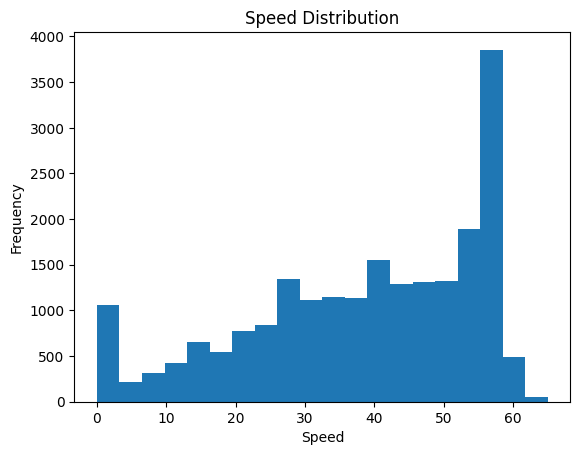

In [31]:
plt.hist(df['Speed'], bins=20)
plt.xlabel('Speed')
plt.ylabel('Frequency')
plt.title('Speed Distribution')
plt.show()

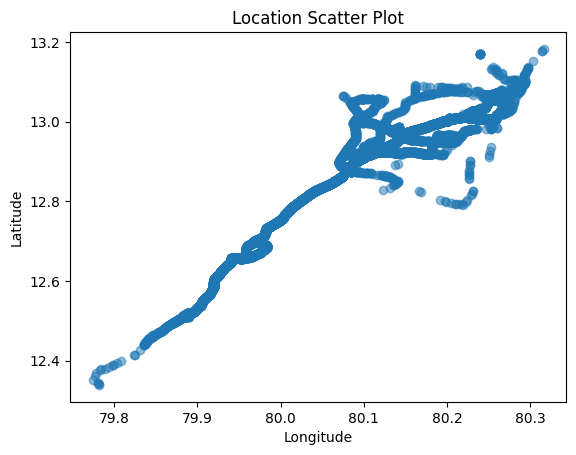

In [32]:
plt.scatter(df['Long'], df['Lat'], alpha=0.5)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Location Scatter Plot')
plt.show()

In [33]:
avg_speed = df['Speed'].mean()
print(f"Average Speed: {avg_speed:.2f}")

Average Speed: 38.40


In [34]:
alert_counts = df['Alert'].value_counts()
print(alert_counts)

Alert
cas_hmw    12328
cas_ldw     6431
cas_pcw     1976
cas_fcw      590
Name: count, dtype: int64


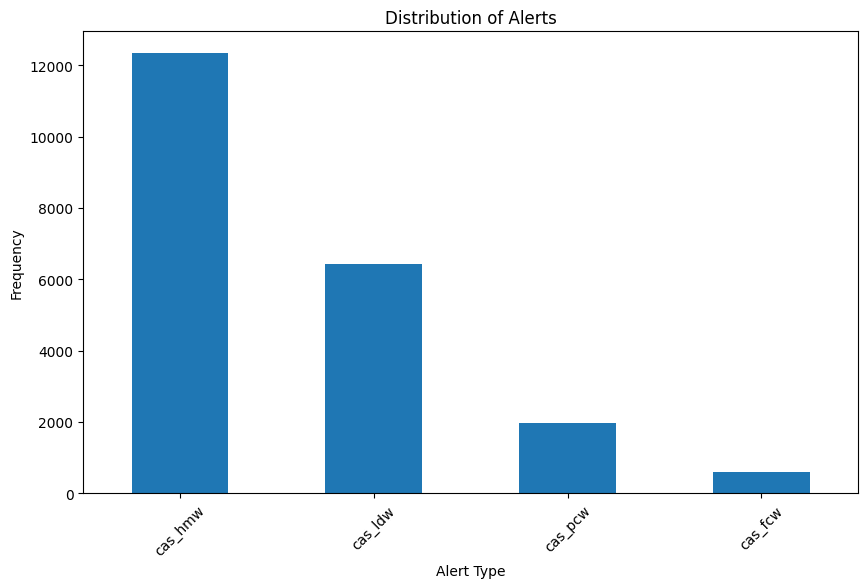

In [35]:
plt.figure(figsize=(10, 6))
alert_counts.plot(kind='bar')
plt.xlabel('Alert Type')
plt.ylabel('Frequency')
plt.title('Distribution of Alerts')
plt.xticks(rotation=45)
plt.show()

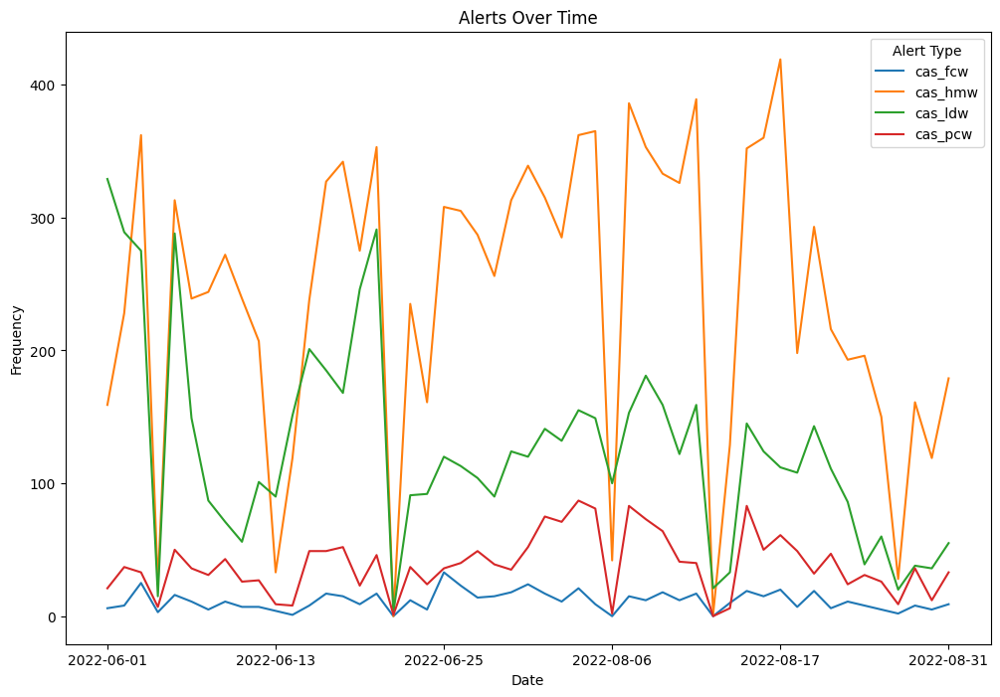

In [36]:
alert_over_time = df.groupby(['Date', 'Alert']).size().unstack(fill_value=0)
alert_over_time.plot(figsize=(12, 8))
plt.xlabel('Date')
plt.ylabel('Frequency')
plt.title('Alerts Over Time')
plt.legend(title='Alert Type', loc='upper right')
plt.show()

In [37]:
avg_speed_by_alert = df.groupby('Alert')['Speed'].mean()
print(avg_speed_by_alert)

Alert
cas_fcw    36.366102
cas_hmw    35.316596
cas_ldw    50.923496
cas_pcw    17.527328
Name: Speed, dtype: float64


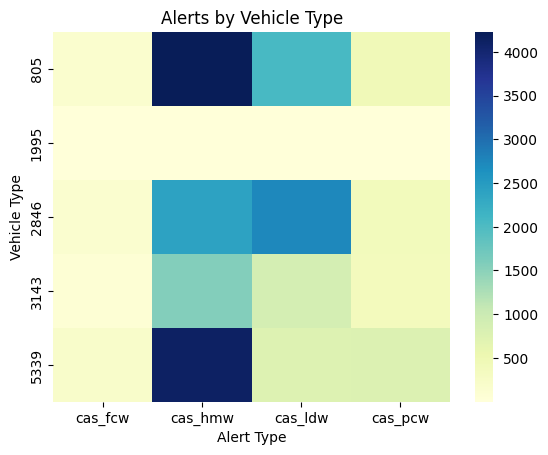

In [38]:
alert_counts_by_vehicle = df.groupby(['Vehicle', 'Alert']).size().unstack(fill_value=0)
sns.heatmap(alert_counts_by_vehicle, cmap='YlGnBu')
plt.xlabel('Alert Type')
plt.ylabel('Vehicle Type')
plt.title('Alerts by Vehicle Type')
plt.show()

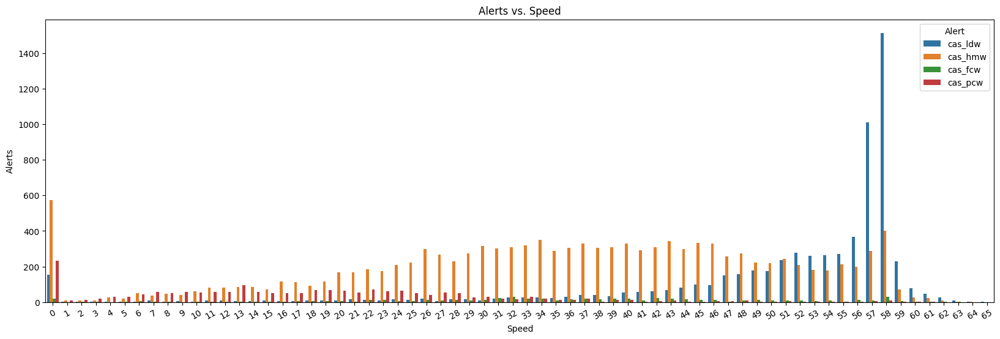

In [39]:
plt.figure(figsize=(20, 6))
sns.countplot(data=df, x='Speed', hue='Alert')
plt.xlabel('Speed')
plt.ylabel('Alerts')
plt.title('Alerts vs. Speed')
plt.legend(title='Alert')
plt.xticks(rotation=30)

plt.show()

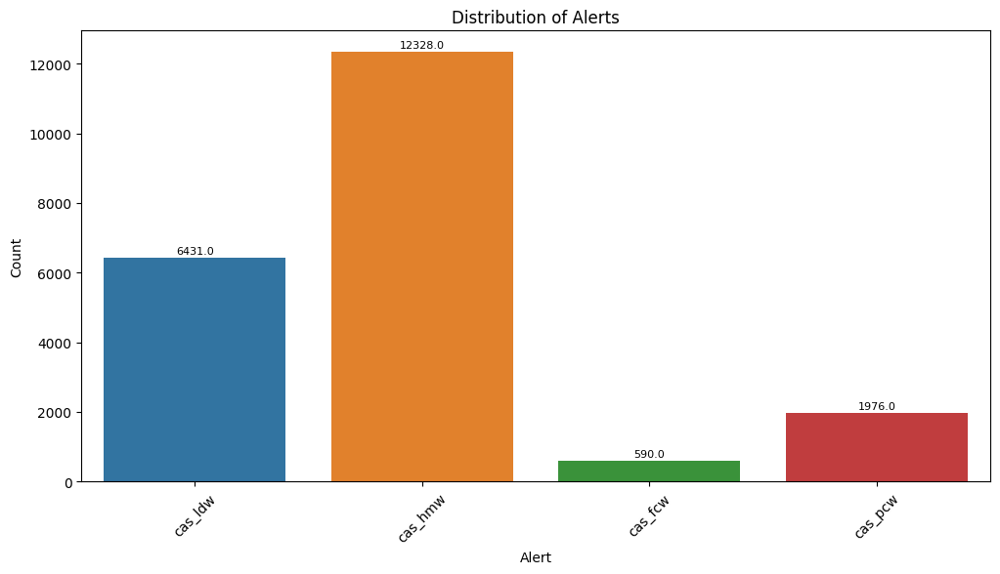

In [40]:
plt.figure(figsize=(12, 6))
sns.countplot(data=df, x='Alert')
plt.xlabel('Alert')
plt.ylabel('Count')
plt.title('Distribution of Alerts')
plt.xticks(rotation=45)

ax = plt.gca()
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=8, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()

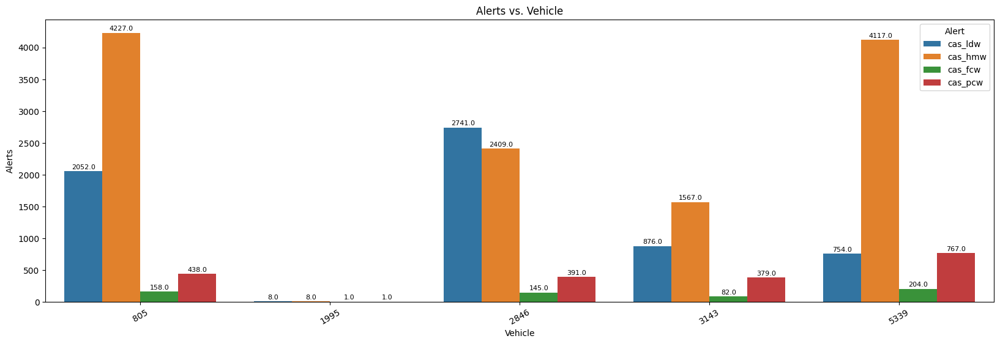

In [74]:
plt.figure(figsize=(20, 6))
sns.countplot(data=df, x='Vehicle', hue='Alert')
plt.xlabel('Vehicle')
plt.ylabel('Alerts')
plt.title('Alerts vs. Vehicle')
plt.legend(title='Alert')
plt.xticks(rotation=30)
ax = plt.gca()

for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=8, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()

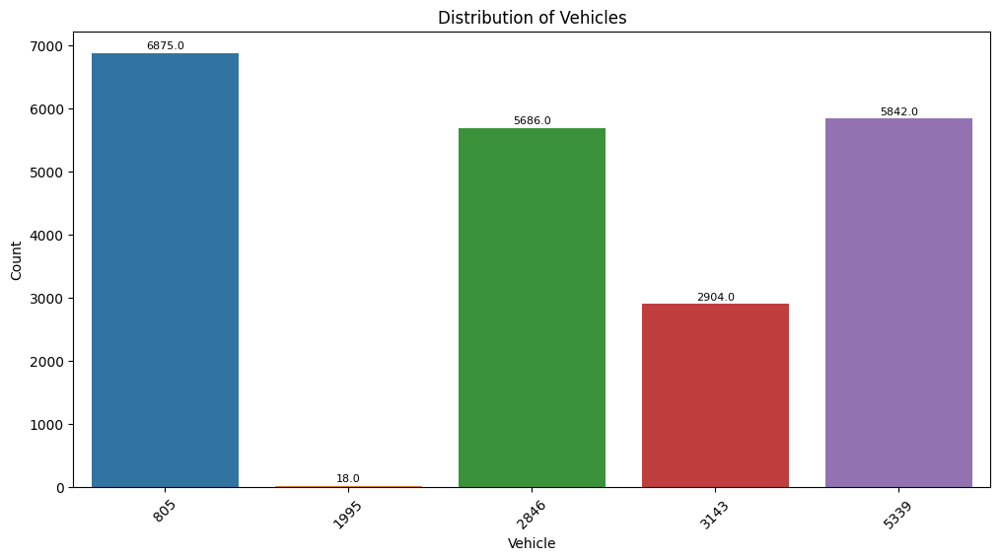

In [42]:
plt.figure(figsize=(12, 6))
sns.countplot(data=df, x='Vehicle')
plt.xlabel('Vehicle')
plt.ylabel('Count')
plt.title('Distribution of Vehicles')
plt.xticks(rotation=45)

ax = plt.gca()
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=8, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()

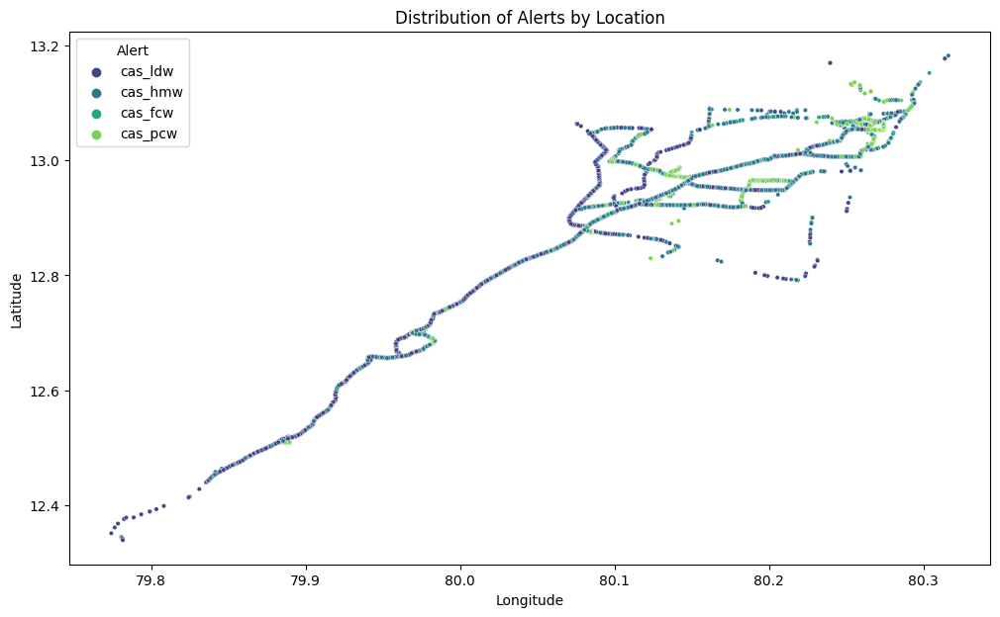

In [43]:
plt.figure(figsize=(12,7))
sns.scatterplot(data=df, x='Long', y='Lat', hue='Alert', palette='viridis', s=10)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Distribution of Alerts by Location')

plt.show()

C:\Users\MOGAL\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\distributions.py:1138: UserWarning: cmap parameter ignored when using hue mapping.
  warnings.warn(msg, UserWarning)


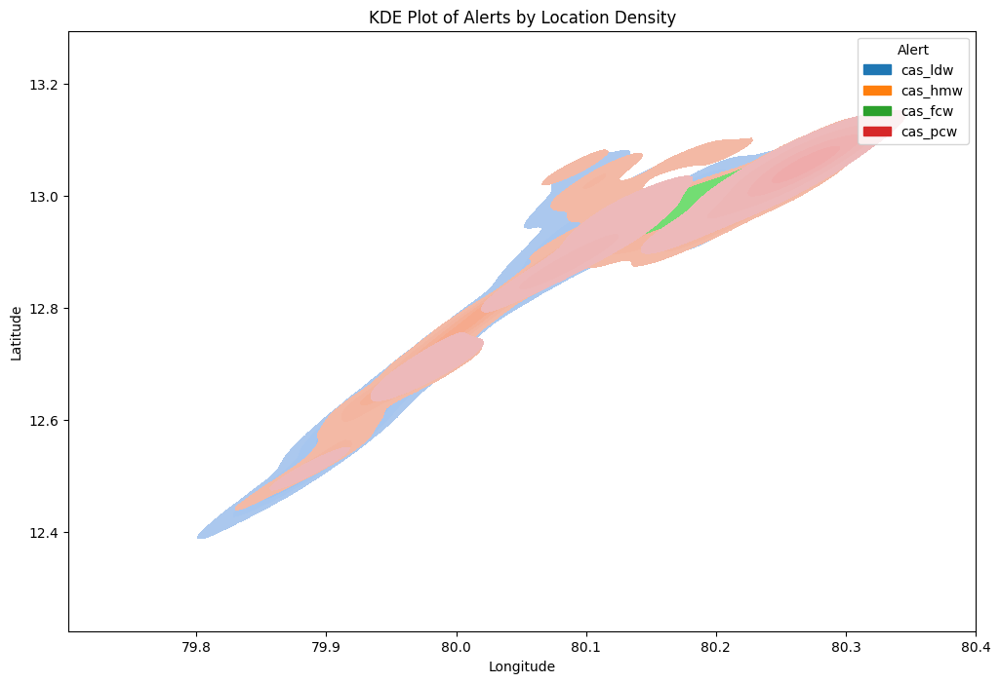

In [44]:
plt.figure(figsize=(12, 8))
sns.kdeplot(data=df,hue = 'Alert', x='Long', y='Lat', cmap='jet', fill=True)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('KDE Plot of Alerts by Location Density')

plt.show()

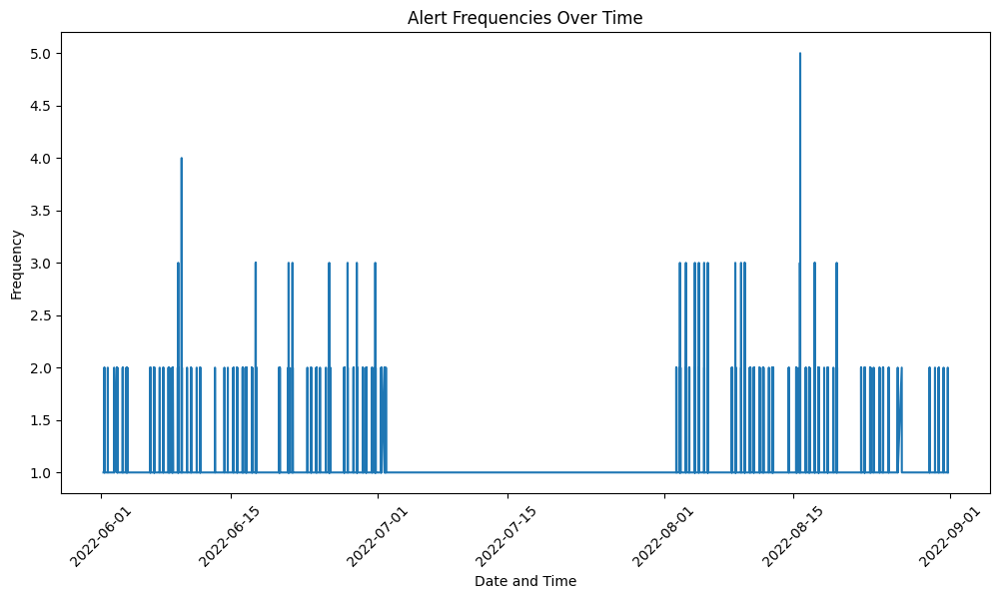

In [45]:
alert_counts = df.groupby('DateTime')['Alert'].count().reset_index()
plt.figure(figsize=(12, 6))
sns.lineplot(data=alert_counts, x='DateTime', y='Alert')
plt.xlabel('Date and Time')
plt.ylabel('Frequency')
plt.title('Alert Frequencies Over Time')
plt.xticks(rotation=45)

plt.show()

In [47]:
pip install geopandas

Note: you may need to restart the kernel to use updated packages.
                                              0.0/1.1 MB ? eta -:--:--
     --------                                 0.2/1.1 MB 7.6 MB/s eta 0:00:01
     ------------------                       0.5/1.1 MB 7.9 MB/s eta 0:00:01
     ----------------------------             0.8/1.1 MB 7.1 MB/s eta 0:00:01
     ---------------------------------------  1.1/1.1 MB 7.6 MB/s eta 0:00:01
     ---------------------------------------- 1.1/1.1 MB 6.3 MB/s eta 0:00:00
                                              0.0/22.7 MB ? eta -:--:--
                                              0.4/22.7 MB 12.5 MB/s eta 0:00:02
     -                                        0.8/22.7 MB 9.8 MB/s eta 0:00:03
     --                                       1.2/22.7 MB 11.0 MB/s eta 0:00:02
     --                                       1.6/22.7 MB 10.1 MB/s eta 0:00:03
     ---                                      1.9/22.7 MB 9.5 MB/s eta 0:00:03
   


[notice] A new release of pip is available: 23.1.2 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [66]:
import geopandas as gpd

tamil_nadu = gpd.read_file("tamil_nadu_administrative.shp")

In [67]:
from shapely.geometry import Point, Polygon

geometry = [Point(xy) for xy in zip(df['Long'], df['Lat'])]
gdf = gpd.GeoDataFrame(df, geometry=geometry, crs=tamil_nadu.crs)

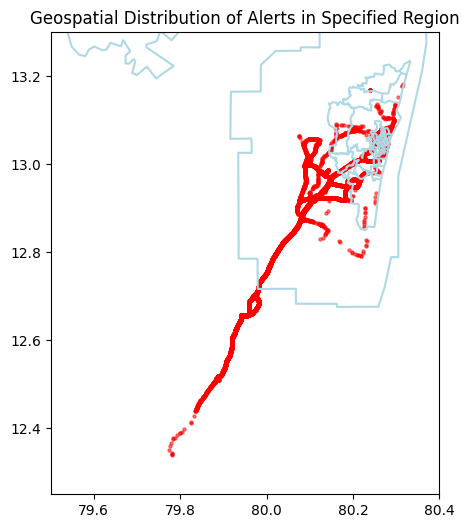

In [68]:
latitude_min, latitude_max = 12.25, 13.3  
longitude_min, longitude_max = 79.5, 80.4 


filtered_data = df[(df['Lat'] >= latitude_min) & (df['Lat'] <= latitude_max) &
                   (df['Long'] >= longitude_min) & (df['Long'] <= longitude_max)]


base = tamil_nadu.plot(figsize=(10, 6), color='lightblue', edgecolor='black')
plt.xlim(longitude_min, longitude_max)  
plt.ylim(latitude_min, latitude_max)  


plt.scatter(filtered_data['Long'], filtered_data['Lat'], alpha=0.5, color='red', s=5)

plt.title('Geospatial Distribution of Alerts in Specified Region')
plt.show()

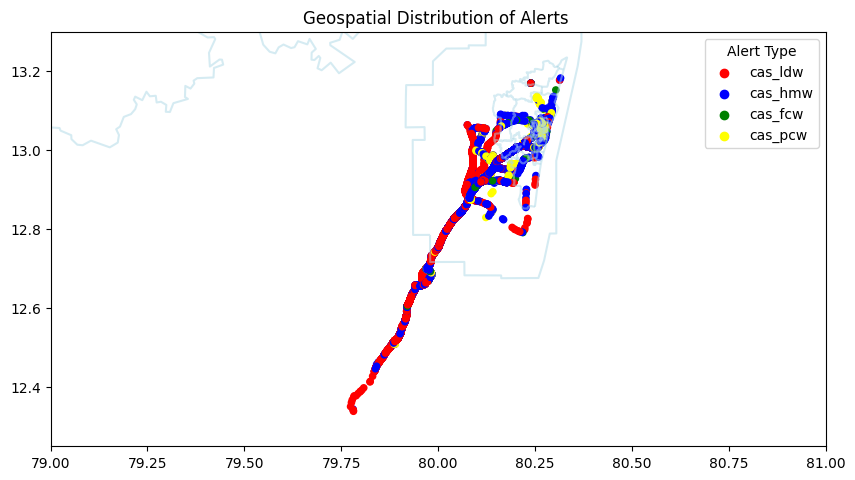

In [69]:
latitude_min, latitude_max = 12.25, 13.3
longitude_min, longitude_max = 79, 81

filtered_data = df[(df['Lat'] >= latitude_min) & (df['Lat'] <= latitude_max) &
                   (df['Long'] >= longitude_min) & (df['Long'] <= longitude_max)]

alert_colors = {
    'cas_ldw': 'red',
    'cas_hmw': 'blue',
    'cas_fcw': 'green',
    'cas_pcw': 'yellow'
}
filtered_data['Alert_Color'] = filtered_data['Alert'].map(alert_colors)

base = tamil_nadu.plot(figsize=(10, 6), color='lightblue', edgecolor='black', alpha=0.5)
plt.xlim(longitude_min, longitude_max) 
plt.ylim(latitude_min, latitude_max) 

plt.scatter(filtered_data['Long'], filtered_data['Lat'], c=filtered_data['Alert_Color'], s=20, label=None)

for alert, color in alert_colors.items():
    plt.scatter([], [], c=color, label=alert)

plt.legend(loc='upper right', title='Alert Type')
plt.title('Geospatial Distribution of Alerts ')
plt.show()

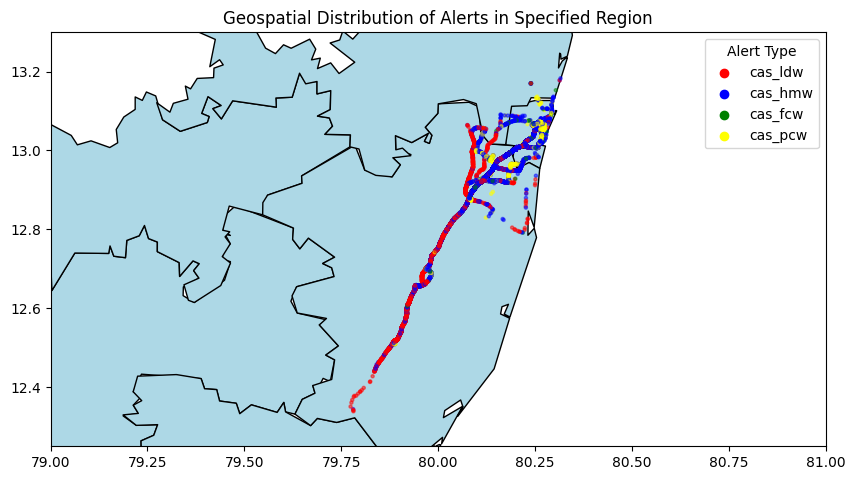

In [70]:
tamil_nadu2 = gpd.read_file('TamilNadu.geojson')

latitude_min, latitude_max = 12.25, 13.3
longitude_min, longitude_max = 79, 81

filtered_data = df[(df['Lat'] >= latitude_min) & (df['Lat'] <= latitude_max) &
                   (df['Long'] >= longitude_min) & (df['Long'] <= longitude_max)]

alert_colors = {
    'cas_ldw': 'red',
    'cas_hmw': 'blue',
    'cas_fcw': 'green',
    'cas_pcw': 'yellow'
}

filtered_data['Alert_Color'] = filtered_data['Alert'].map(alert_colors)

base = tamil_nadu2.plot(figsize=(10, 6), color='lightblue', edgecolor='black')
plt.xlim(longitude_min, longitude_max) 
plt.ylim(latitude_min, latitude_max)  

plt.scatter(filtered_data['Long'], filtered_data['Lat'], alpha=0.5, c=filtered_data['Alert_Color'], s=5)

for alert, color in alert_colors.items():
    plt.scatter([], [], c=color, label=alert)

plt.legend(loc='upper right', title='Alert Type')
plt.title('Geospatial Distribution of Alerts in Specified Region')
plt.show()


<Figure size 1200x600 with 0 Axes>

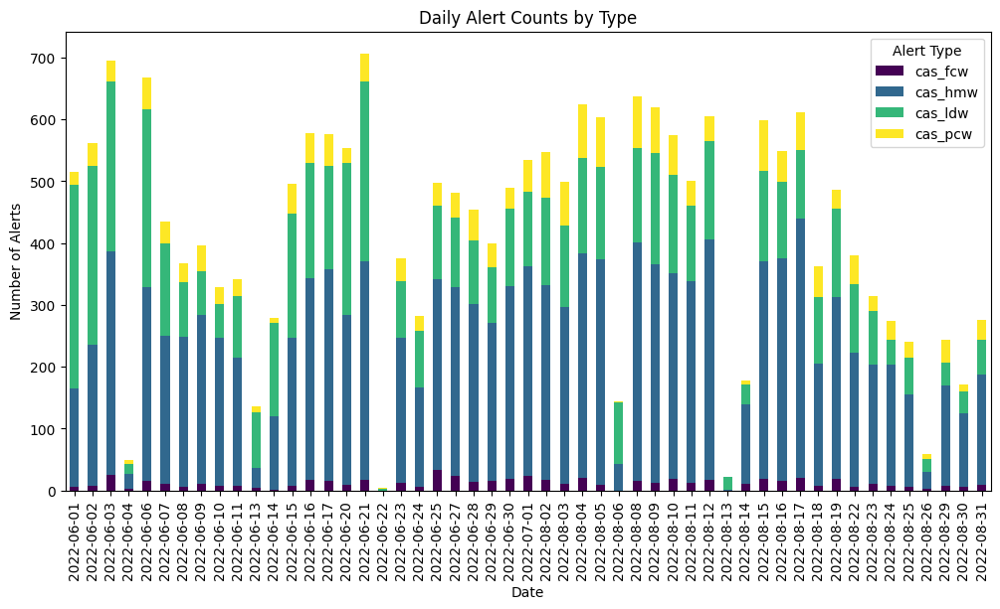

In [72]:
df.set_index('DateTime', inplace=True)
daily_alert_counts = df.groupby([df.index.date, 'Alert']).size().unstack(fill_value=0)
plt.figure(figsize=(12, 6))
daily_alert_counts.plot(kind='bar', stacked=True, colormap='viridis', figsize=(12, 6))
plt.title('Daily Alert Counts by Type')
plt.xlabel('Date')
plt.ylabel('Number of Alerts')
plt.legend(title='Alert Type')
plt.show()

In [55]:
import folium
from folium.plugins import MarkerCluster

m = folium.Map(location=[df['Lat'].mean(), df['Long'].mean()], zoom_start=20)

marker_cluster = MarkerCluster().add_to(m)

for index, row in df.iterrows():
    lat, lon = row['Lat'], row['Long']
    alert_type = row['Alert']

    folium.Marker([lat, lon], 
                  popup=f"Alert Type: {alert_type}<br>Frequency: {df[df['Alert'] == alert_type].shape[0]}").add_to(marker_cluster)

m.save('alert_map.html')

m

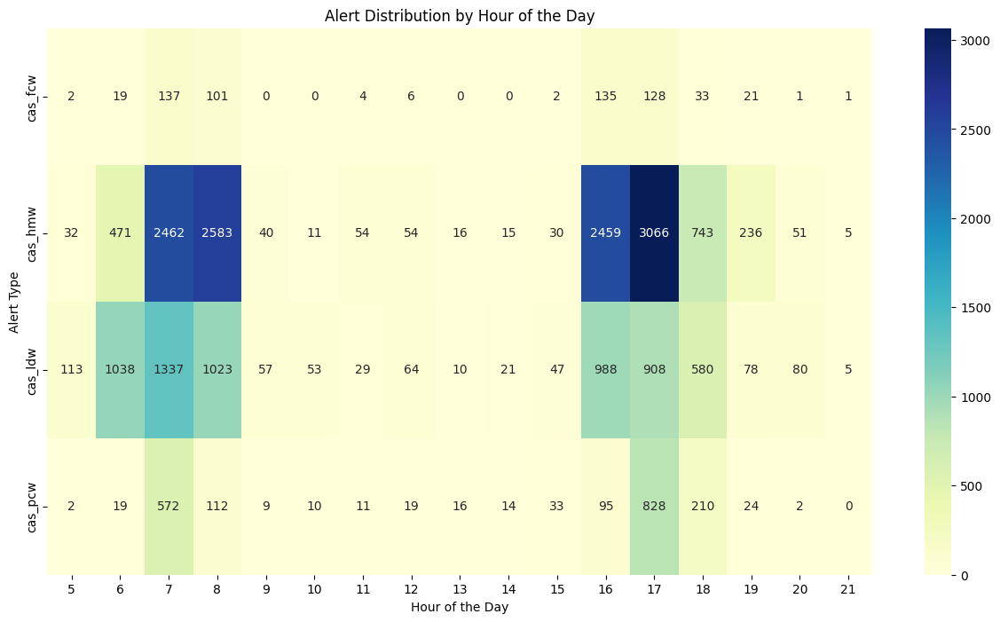

In [61]:
df['Hour'] = df['DateTime'].dt.hour

alert_distribution = df.pivot_table(index='Alert', columns='Hour', values='Date', aggfunc='count', fill_value=0)

plt.figure(figsize=(15, 8))
sns.heatmap(alert_distribution, cmap='YlGnBu', annot=True, fmt='d')
plt.xlabel('Hour of the Day')
plt.ylabel('Alert Type')
plt.title('Alert Distribution by Hour of the Day')
plt.show()

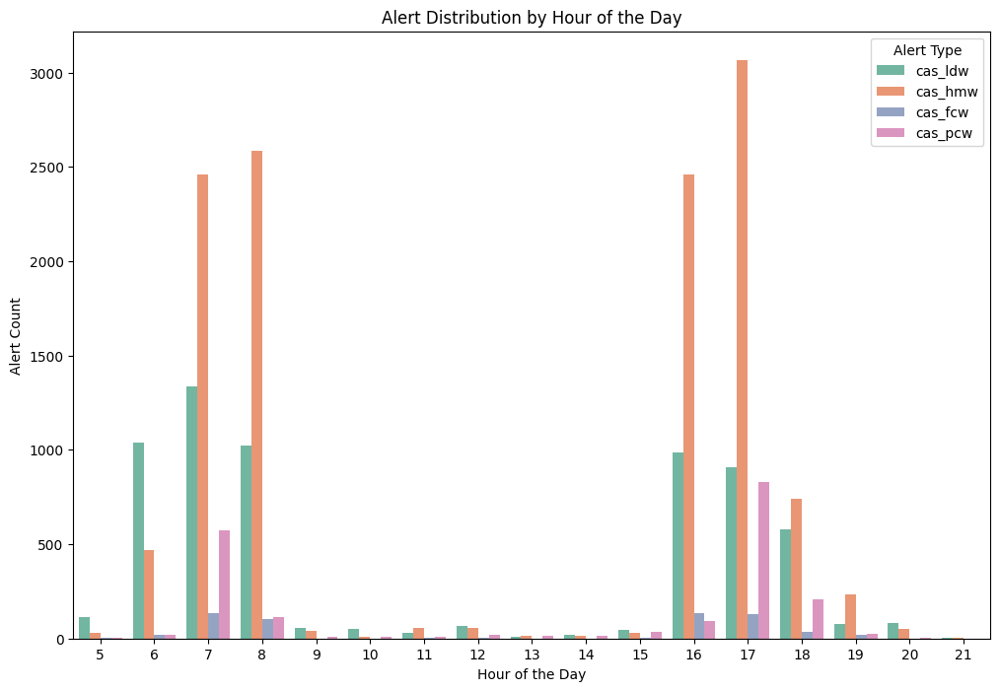

In [65]:
df['Hour'] = df['DateTime'].dt.hour

plt.figure(figsize=(12, 8))
sns.countplot(data=df, x='Hour', hue='Alert', palette='Set2')
plt.xlabel('Hour of the Day')
plt.ylabel('Alert Count')
plt.title('Alert Distribution by Hour of the Day')
plt.legend(title='Alert Type')
plt.show()